In [1]:
import numpy as np
import pandas as pd 

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.stats.proportion as ssprop   # for standardized effect size
import statsmodels.stats.power as ssp           # for traditional power analysis

import scipy

# Experimental Design: The Basics
This notebook draws heavily from chapter 8 of Florent Buisson's Behavioral Data Analysis in R and Python. In this notebook we imagine a company like Airnbnb would like to experiment on implementing a 1 click booking button. In this hypothetical scenario historical data is provided in order to do sample size and power analysis and experiment data is provided to do the experiment analysis itself. Notably, this chapter provides an alternative approach to the standard T test used widely. Buisson instead focuses on using linear or logistic regression and then using the bootstrap to provides confidence intervals and draw the final conclusion.

While the book provides valuable information on how exactly to go abouty designing an experiment and ensuring that randomization is done properly etc, the main focus of this notebook will be on Buisson's analysis approach using regression, the bootstrap and how to do sample size and power analysis given this method.


### Importing the datasets

In [2]:
hist_url = 'https://raw.githubusercontent.com/FlorentBuissonOReilly/BehavioralDataAnalysis/master/Chapter%208%20-%20Experimental%20Design%20-%20the%20Basics/chap8-historical_data.csv'
exp_url = 'https://raw.githubusercontent.com/FlorentBuissonOReilly/BehavioralDataAnalysis/master/Chapter%208%20-%20Experimental%20Design%20-%20the%20Basics/chap8-experimental_data.csv'

hist_df = pd.read_csv(hist_url)
exp_df = pd.read_csv(exp_url)

display("Historical Data:",hist_df.head())
display("Experimental Data:", exp_df.head())


'Historical Data:'

,age,gender,period,seasonality,month,booked
0,34,male,1,0.749993,2,0
1,39,male,1,0.749993,2,0
2,42,male,1,0.749993,2,0
3,33,male,1,0.749993,2,0
4,32,male,1,0.749993,2,1


'Experimental Data:'

,age,gender,period,seasonality,month,booked,oneclick
0,47,male,33,6.492170e-08,10,0,1
1,49,male,33,6.492170e-08,10,0,1
2,37,male,33,6.492170e-08,10,0,0
3,44,male,33,6.492170e-08,10,0,1
4,45,male,33,6.492170e-08,10,0,1


### The Historical Data 

Before running an experiment it is essential to look at historical performance of your target metric. In this case the target metric is the probability of completing a booking. Importantly, even this is not a specific enough target metric. For instance, we can infer via the data Buisson provides that this applies to the user and most likely applies only to users that visited the website during the period for which the historical data was collected. 

What we don't know is how long (or how short) of a time window each user had to complete a booking or whether this window was consistent across users. For example, the Data Scientist who collected this historical data may have taken the simplest approach and pulled all the users who made a visit in the past 12 months and assessed whether they made a booking. This approach would give users who visited 12 months ago a much longer window than users who just made a visit last week. Alternatively, the Data Scientist may have grouped users with a visit in a given month and assessed if they made a booking, this too would have its own caveats. Finally the DS could have given each user exactly an equal time window to book like 4 weeks etc. this would likely be the most precise method but also the most complex.

While all of these are potential approaches I would likely advocate for the first (simplest) approach making sure to draw from a representative historical time window. I recommend this approach for two reasons: 1) Its simple 2) It mimics the most natural way to analyse the experiment itself. People come into the experiment at different times, are exposed for different durations, it makes sense to let this dynamic play out as it would in the experiment and in the real world.



In [3]:
hist_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 319757 entries, 0 to 319756
Data columns (total 6 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   age          319757 non-null  int64  
 1   gender       319757 non-null  object 
 2   period       319757 non-null  int64  
 3   seasonality  319757 non-null  float64
 4   month        319757 non-null  int64  
 5   booked       319757 non-null  int64  
dtypes: float64(1), int64(4), object(1)
memory usage: 14.6+ MB


In [4]:
hist_df.describe()

,age,period,seasonality,month,booked
count,319757.000000,319757.000000,3.197570e+05,319757.000000,319757.000000
mean,39.428682,16.486163,5.371993e-01,6.251294,0.182464
std,5.492274,9.224951,3.514633e-01,3.232693,0.386227
min,15.000000,1.000000,4.828887e-09,1.000000,0.000000
25%,36.000000,8.000000,2.499264e-01,4.000000,0.000000
50%,39.000000,16.000000,5.001390e-01,6.000000,0.000000
75%,43.000000,24.000000,9.329123e-01,9.000000,0.000000
max,64.000000,32.000000,1.000000e+00,12.000000,1.000000


In [5]:
hist_df.corr()

,age,period,seasonality,month,booked
age,1.000000,0.203558,-0.045476,0.082179,-0.473465
period,0.203558,1.000000,-0.126676,0.105192,-0.104545
seasonality,-0.045476,-0.126676,1.000000,-0.775930,0.180111
month,0.082179,0.105192,-0.775930,1.000000,-0.149791
booked,-0.473465,-0.104545,0.180111,-0.149791,1.000000


In [6]:
hist_df_long = pd.melt(hist_df, var_name='feature')
px.histogram(hist_df_long, 
    x = 'value',
    facet_col = 'feature',
    title = 'Historgrams of the variables in our historical data'
    ).update_xaxes(matches = None).show()

#### Whats the historical booking rate?

In [7]:
hist_df['booked'].mean()

0.18246355826455715

## Traditional Sample Size/Power Analysis

To conduct traditional frequentist sample size and power analysis we can use the booking rate observed in the historcial data as an input into some useful statsmodels functions. This section assumes we'll use a traditional t test of proportions (booking rate between the experiment groups) to do our analysis. This is a totally acceptable approach and is used widely.

There are 3 common ways to think about effect size for an experiment: absolute, relative and standardized. The absolute effect size is simply difference between the treatment and control. The relative effect size is the percent change between the treatment and control. The standardized effect size is typically the raw difference divided by the standard deviation. Cohen's D is a common formulation of standardized effect size. Statsmodels power and sample size calculator requires a standardized effect size which can be obtained using their proportion_effectsize function (for proportions), for continuous data use Cohen's D. See here: [Effect sizes for differences of means](https://en.wikipedia.org/wiki/Effect_size#Difference_family:_Effect_sizes_based_on_differences_between_means)

Below we start with a relative effect size since this is the most interpretable. We then convert this to an absolute effect size that can then be fed into statsmodels' proportion_effectsize function to be converted to an standardized effect. This can then be used to calculate sample size requirements.



In [11]:
### Suppose we wish to detect a 5% relative effect with an alpha 5% and power of 80%
baseline = hist_df['booked'].mean()

# get the absolute effect size
baseline_with_lift = 1.05*baseline

# Statsmodels' power calculator requires the effect size to be standardized, the following line of code conveniently provides this for us
standardized_effect_size = ssprop.proportion_effectsize(baseline_with_lift, baseline)

# Sample size calculator
control_sample_size = ssp.tt_ind_solve_power(effect_size= standardized_effect_size,
                                            alpha = .05,
                                            nobs1= None,                # 'None' lets statsmodels know this is what variable it is solving for, this is the sample size required for group 1
                                            alternative= 'two-sided',       # 'larger' effectively means were doing a non inferiority test i.e. the treatment group is not worse than control 
                                            power = .8,
                                            ratio = 1                  # this can be modified if you want more units in control than treatment, recommend to leave this set to 1 (equal split)
                                            )

total_exp_sample_size = control_sample_size*2
print("Sample size required per variant:", control_sample_size)
print("Total sample size required:", total_exp_sample_size)

Sample size required per variant: 28673.312914018923
Total sample size required: 57346.625828037846


### How long will it take to get this many users in the experiment?
To answer this question lets go back to the historcial data and see if we can tease it out...

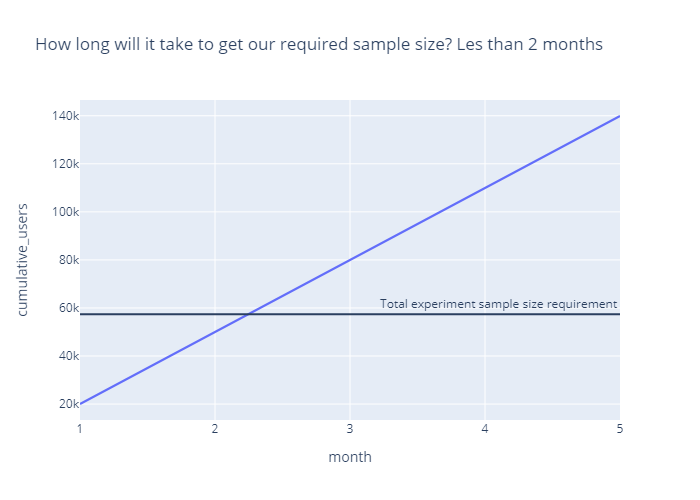

In [10]:
## Lets assume that the index serves as an effective unique user id
hist_df['userid'] = hist_df.index

hist_monthly = hist_df.groupby('month', as_index=False).agg(users = ('userid', 'nunique'))
hist_monthly['cumulative_users'] = hist_monthly['users'].cumsum()


fig = px.line(hist_monthly.query("month < 6"),
    x = 'month',
    y = 'cumulative_users',
    title = 'How long will it take to get our required sample size? Les than 2 months')
    
fig.add_hline(y = total_exp_sample_size,
                annotation_text="Total experiment sample size requirement")
    
fig.show('png')

### What about mapping several effect sizes? 

In [72]:
def sample_size_calculator(baseline, percent_effect, alpha, power, alternative):
    
    baseline_with_lift = (1+percent_effect)*baseline

    # Statsmodels' power calculator requires the effect size to be standardized, the following line of code conveniently provides this for us
    standardized_effect_size = ssprop.proportion_effectsize(baseline_with_lift, baseline)

    # Sample size calculator
    control_sample_size = ssp.tt_ind_solve_power(effect_size= standardized_effect_size,
                                                alpha = alpha,
                                                nobs1= None,                # None lets statsmodels know this is what it is solving for, this is the sample size required for group 1
                                                alternative= alternative,       # 'larger' effectively means were doing a non inferiority test i.e. the treatment group is not worse than control 
                                                power = power,
                                                ratio = 1                  # this can be modified if you want more units in control than treatment, recommend to leave this set to 1 (equal split)
                                                )
    return(control_sample_size*2)


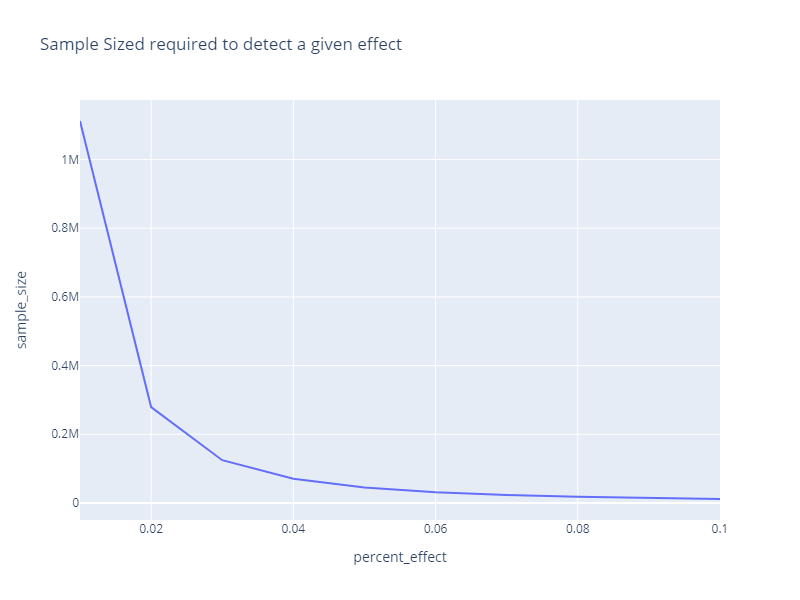

In [77]:
percent_effects = [.10,.09,.08,.07,.06,.05,.04,.03,.02,.01]

sample_sizes = []

for i in percent_effects:
    sample_size = sample_size_calculator(baseline=hist_df['booked'].mean(), percent_effect = i, alpha = .05, power = .8, alternative='larger' )
    sample_sizes.append(sample_size)

ss_df = pd.DataFrame(data = {'percent_effect':percent_effects,'sample_size':sample_sizes})

px.line(ss_df,
    x = 'percent_effect',
    y = 'sample_size',
    title = 'Sample Sized required to detect a given effect',
    height = 600,
    width= 800).show('png')

## Power Analysis using Bootstrap Simulations

Suppose we want to use logistic regression for the analysis of our experiment. One of the upsides of doing this is that we could include covariates we know affect booking but only add noise to our experimental data (with random assignment our treatment effect will be unbiased but there is still noise from other factors!). We could rely on the standard errors in the regression model to get confidence intervals but this requires assumptions of normality. Inestead we could use bootstrap simiulations. Thats what we'll do here and in additiona we'll see how to conduct power analysis using this method.

In [88]:
### this will be the logit model we use to analyze the experiment. Age and gender are used to reduce noise. 
    # Recall: Our target metric is 'probability of booking' we can get this directly from the 
def log_reg_function(df):
    model = smf.logit('booked ~ oneclick + age + gender', data = df)
    result = model.fit(disp = 0)
    coeff = result.params['oneclick']
    return coeff

### Bootstrap simulation function
def boot_ci_function(df, metric_function, nboots = 100, confidence_level = .9):
    # Set the sample size
    N = len(df)
    confidence_level = confidence_level
    coeffs = []

    for i in range(nboots):
        sim_data_df = df.sample(n = N, replace = True)
        coeff = metric_function(sim_data_df)
        coeffs.append(coeff)

    coeffs.sort()
    start_idx = round(nboots * (1 - confidence_level) / 2)
    end_idx = - round(nboots * (1 - confidence_level) / 2)
    confint = [coeffs[start_idx], coeffs[end_idx]]
    return(confint)

### Decision rule function: This will indicate the result of the experiment (1 for launch) equivalent to launching if the p-val is less than .1
def decision_function(df, metric_function, nboots = 100, confidence_level = .9):
    boot_ci = boot_ci_function(df, metric_function, nboots = nboots, confidence_level=confidence_level)
    decision = 1 if boot_ci[0] > 0 else 0       # This is the meat of the function
    return(decision)

### Function to run a single simulation of the experiment
    # Recall: Since we're simulating the actual experiment we need to asign units to treatment/control and 
    # build in a hypothetical effect, we also need to specify the number of observations in the experiment!
def single_sim_fun(Nexp, df = hist_df, metric_function = log_reg_function, 
                   effect_size = 0.01, nboots = 100, confidence_level = 0.9):
    
    #Adding predicted probability of booking
    hist_model = smf.logit('booked ~ age + gender + period', data = df)
    res = hist_model.fit(disp=0)
    sim_data_df = df.copy()
    sim_data_df['pred_prob_bkg'] = res.predict()
    #Filtering down to desired sample size
    sim_data_df = sim_data_df.sample(Nexp)
    #Random assignment of experimental groups
    sim_data_df['oneclick'] = np.where(np.random.uniform(size=Nexp) <= 0.5, 0, 1)
    # Adding effect to treatment group
    sim_data_df['pred_prob_bkg'] = np.where(sim_data_df.oneclick == 1, 
                                            sim_data_df.pred_prob_bkg + effect_size, 
                                            sim_data_df.pred_prob_bkg)
    sim_data_df['booked'] = np.where(sim_data_df.pred_prob_bkg >= \
                                     np.random.uniform(size=Nexp), 1, 0)
    
    #Calculate the decision (we want it to be 1)
    decision = decision_function(sim_data_df, metric_function = metric_function, nboots = nboots,  confidence_level = confidence_level)
     
    return decision  

### Function to copmute power of a specified experiment simulation
    # Power in this appraoch is the fraction of experiments with a true positive effect that have estimated 
    # confidence intervals for the effect that are stricrtly above 0
def power_sim_fun(df, metric_function, Nexp, effect_size, Nsim, nboots = 100, confidence_level = 0.9):
    power_lst = []
    for i in range(Nsim):
        power_lst.append(single_sim_fun(Nexp = Nexp, 
                                        df = df, 
                                        metric_function = metric_function, 
                                        effect_size = effect_size, 
                                        nboots = nboots, 
                                        confidence_level = confidence_level))
    power = np.mean(power_lst)
    return(power)


### Running a simulated experiment to assess power
 Lets take our 45000 required sample size from above and see what power we get when we have an effect size of 1 percentage point on booking probability. Note that above we used the a 1% increase instead of 1 percentage point (1.01*.18 versus 18 + 1). I prefer my way (above) Buisson did it this other way whih makes more sense in the context of Logistic regression but nevertheless its important to see the difference.

In [90]:
# Note 20 simlutions took 10 minutes! This method is slowwwww
power_sim_fun(df = hist_df, metric_function = log_reg_function, Nexp = 45000, effect_size = .01, Nsim=20)

KeyboardInterrupt: 